# Earthquake_basemap
> Non-Euclidean geometry

- toc:true
- branch: master
- badges: true
- comments: false
- author: 최서연
- categories: [Graph Laplacian, PCA, eigendecomposition]

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt 
import networkx as nx

In [2]:
import warnings
warnings.simplefilter("ignore", np.ComplexWarning)

In [5]:
from haversine import haversine

In [6]:
import time

##### 1. Data

In [7]:
df = pd.read_csv('https://raw.githubusercontent.com/plotly/datasets/master/earthquakes-23k.csv')

In [8]:
_df = df.assign(Year=list(map(lambda x: x.split('/')[-1], df.Date))).query('Year>="2004" & Year<="2011"').reset_index().iloc[:,1:]

##### 2. $f(x)$ 

In [9]:
f_true = np.array(_df.loc[:,"Magnitude"])

In [10]:
f = (f_true-f_true.mean())/f_true.std()

In [11]:
f@f ## SST 

4517.000000000005

In [12]:
(f-np.mean(f))@(f-np.mean(f)) ## SSE

4517.000000000003

In [13]:
(f*0-np.mean(f))@(f*0-np.mean(f)) ## SSH

3.022296055212013e-29

##### 3. Haversine Fomula 사용한 거리 정의

In [14]:
locations = np.array(_df.iloc[:,[1,2]])

In [15]:
N = len(f)

In [16]:
dist_matrix = np.zeros((N,N))

In [17]:
for i in range(N):
    for j in range(i,N): 
        dist_matrix[i,j]=haversine(locations[i],locations[j])

In [18]:
dist_matrix = dist_matrix + dist_matrix.T

##### 4. Definition of a weighted adjacency matrix $W$

$$W_{u,v}=\begin{cases}{exp(-\frac{[dist(u,v)]^2}{2\theta^2})} & \quad \text{if } dist(u,v) \leq κ \\ 0 & \quad \text{otherwise} \end{cases}$$

In [19]:
theta,kappa = 10000, 100000

In [20]:
W = np.exp( -(dist_matrix/20000)**2)

(array([ 261472.,  982186., 1180314., 1042392., 1435138., 1600586.,
        2109538., 2632908., 3587594., 5571161.]),
 array([0.36765227, 0.43088704, 0.49412181, 0.55735659, 0.62059136,
        0.68382613, 0.74706091, 0.81029568, 0.87353045, 0.93676523,
        1.        ]),
 <a list of 10 Patch objects>)

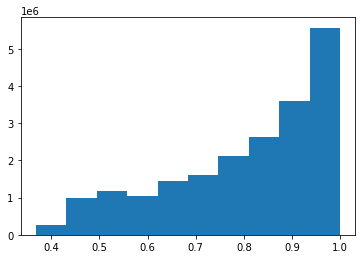

In [21]:
plt.hist(W.reshape(-1))

##### 5. The weight edge function with temporal edge $(v_t,v_{t+1})$

$$W_{u_r,v_s}=\begin{cases} {W_{u,v}} & \quad \text{ if }  u,v \in V_t  \\ W_{u,v} \odot \beta  & \quad \text{if }u=v \text{ and } r=s-1 \\ 0 & \quad \text{otherwise} \end{cases}$$

In [22]:
Nlst = _df.groupby("Year").aggregate(len).Date.tolist()
Nlst = np.cumsum(Nlst)

In [23]:
a=0
_beta =np.zeros((N,N))
for i in range(len(Nlst)):
    b=Nlst[i] 
    _beta[a:b,a:b]= np.ones(b-a)
    a=Nlst[i]

In [24]:
_W = W @ _beta

##### 6. Definition of Graph Laplacian matrix
- $L = D - W$

In [25]:
D = np.diag(_W.sum(axis=1))

In [26]:
L = D - _W

##### 7. Eigendecomposition
- ${\bf L} = {\boldsymbol\Psi} {\boldsymbol\Lambda} {\boldsymbol\Psi}^\top$

In [27]:
λ, Ψ = np.linalg.eig(L)

In [28]:
Λ = np.diag(λ)

##### 8. Principal components Analysis

- $comp_k = f @ np.outer(Ψ[:,k], Ψ[:,k]) $
    - $k = 1, 2, 3, n$
- $p = \sum_{1}^{n} comp_{1}^{2},\sum_{1}^{n} comp_{2}^{2},…,\sum_{1}^{n} comp_{n}^{2}$
- $p = \frac{p}{\sum(p)}$

In [29]:
def p(i):
    return sum((f @ np.outer( Ψ[:,i], Ψ[:,i]))**2)

In [30]:
array_1 = np.array([p(i) for i in range(1,len(f))])
varprop = array_1/array_1.sum()
_index = pd.DataFrame({'index':range(1,len(f)),'varprop':varprop}).sort_values('varprop',ascending=False)
_indexlst = _index.iloc[:25,0].tolist()

In [31]:
_df["comp1"] = f @ np.outer( Ψ[:,0], Ψ[:,0])
_df["comp2"] = f @ np.outer( Ψ[:,_indexlst[0]], Ψ[:,_indexlst[0]])
_df["comp3"] = f @ np.outer( Ψ[:,_indexlst[1]], Ψ[:,_indexlst[1]])
_df["comp4"] = f @ np.outer( Ψ[:,_indexlst[2]], Ψ[:,_indexlst[2]])
_df["comp5"] = f @ np.outer( Ψ[:,_indexlst[3]], Ψ[:,_indexlst[3]])
_df["comp6"] = f @ np.outer( Ψ[:,_indexlst[4]], Ψ[:,_indexlst[4]])
_df["comp7"] = f @ np.outer( Ψ[:,_indexlst[5]], Ψ[:,_indexlst[5]])

In [32]:
#collapse

from itertools import chain
def draw_map(m, scale=0.2):
    # draw a shaded-relief image
    m.shadedrelief(scale=scale)
    
    # lats and longs are returned as a dictionary
    lats = m.drawparallels(np.linspace(-90, 90, 13))
    lons = m.drawmeridians(np.linspace(-180, 180, 13))

    # keys contain the plt.Line2D instances
    lat_lines = chain(*(tup[1][0] for tup in lats.items()))
    lon_lines = chain(*(tup[1][0] for tup in lons.items()))
    all_lines = chain(lat_lines, lon_lines)
    
    # cycle through these lines and set the desired style
    for line in all_lines:
        line.set(linestyle='-', alpha=0.3, color='w')

In [ ]:
!pip install Basemap

In [35]:
from mpl_toolkits.basemap import Basemap

In [55]:
m = Basemap(projection='cyl', resolution=None,
            llcrnrlat=-90, urcrnrlat=90,
            llcrnrlon=-180, urcrnrlon=180, )

##### **2004**, $n=571$

In [36]:
_G1 = nx.Graph(_W[:len(_df.query('Year<="2004"')),:len(_df.query('Year<="2004"'))]-np.identity(len(_df.query('Year=="2004"'))))
_pos1 = nx.spring_layout(_G1,iterations=20)
m_pos1 = list(zip(_df.query('Year=="2004"').Longitude,_df.query('Year=="2004"').Latitude))

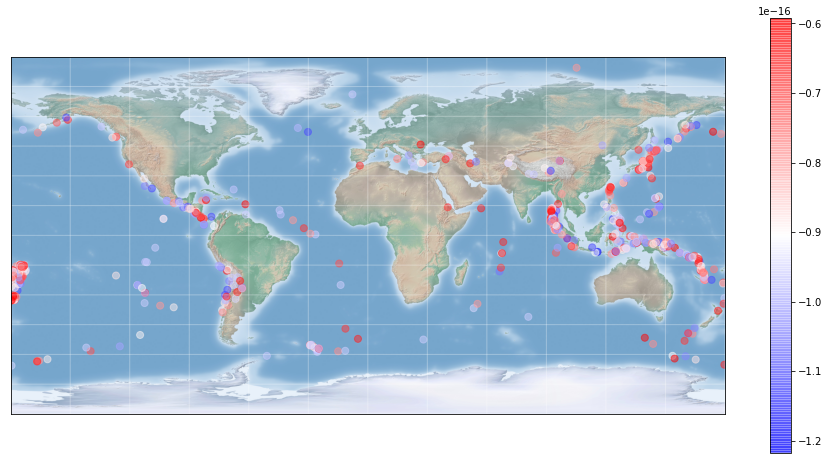

In [56]:
#collapse
fig,ax = plt.subplots(figsize = (16,8))
draw_map(m)
nodes = nx.draw_networkx_nodes(_G1,m_pos1,node_color=_df.query('Year=="2004"').comp1,node_size = 50, ax=ax,cmap='bwr',alpha=0.5)
plt.colorbar(nodes)
plt.axis()
ax.set_axis_on()
ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

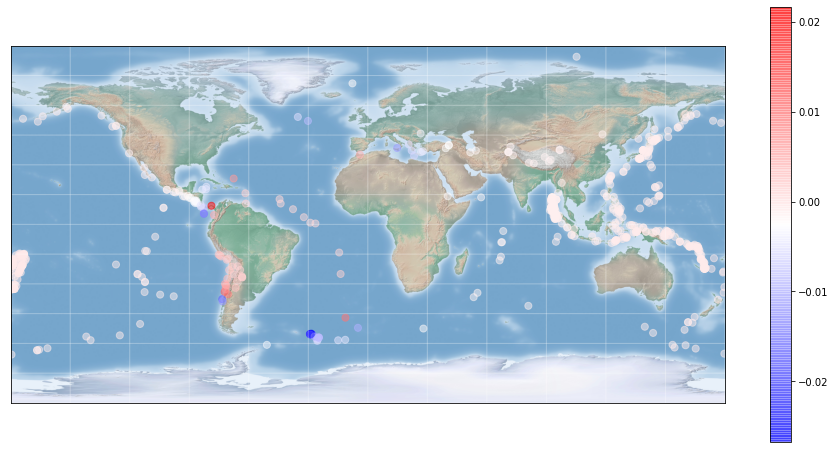

In [66]:
#collapse
fig,ax = plt.subplots(figsize = (16,8))
draw_map(m)
nodes = nx.draw_networkx_nodes(_G1,m_pos1,node_color=_df.query('Year=="2004"').comp2,node_size = 50,ax=ax,cmap='bwr',alpha=0.5)
plt.colorbar(nodes)
plt.axis()
ax.set_axis_on()
ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

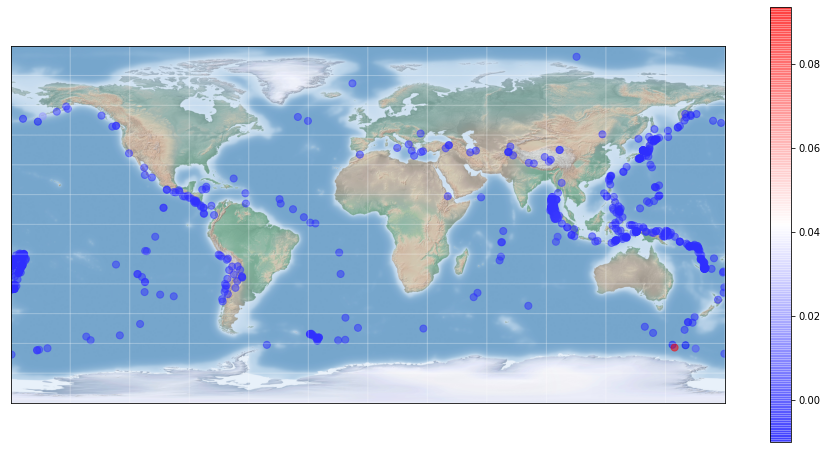

In [67]:
#collapse
fig,ax = plt.subplots(figsize = (16,8))
draw_map(m)
nodes = nx.draw_networkx_nodes(_G1,m_pos1,node_color=_df.query('Year=="2004"').comp3,node_size = 50, ax=ax,cmap='bwr',alpha=0.5)
plt.colorbar(nodes)
plt.axis()
ax.set_axis_on()
ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

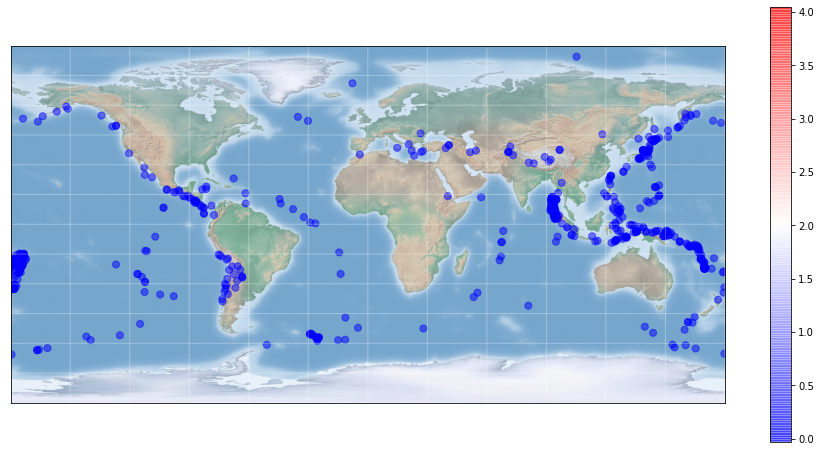

In [71]:
#collapse
fig,ax = plt.subplots(figsize = (16,8))
draw_map(m)
nodes = nx.draw_networkx_nodes(_G1,m_pos1,node_color=_df.query('Year=="2004"').comp4,node_size = 50, ax=ax,cmap='bwr',alpha=0.5)
plt.colorbar(nodes)
plt.axis()
ax.set_axis_on()
ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

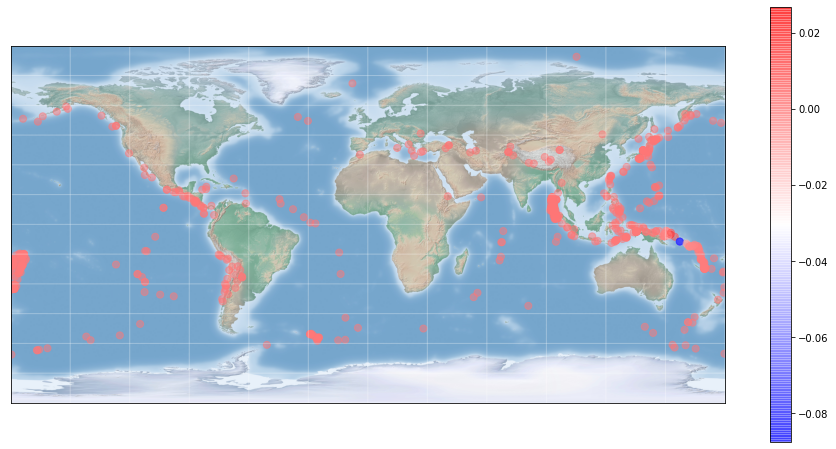

In [76]:
#collapse
fig,ax = plt.subplots(figsize = (16,8))
draw_map(m)
nodes = nx.draw_networkx_nodes(_G1,m_pos1,node_color=_df.query('Year=="2004"').comp5,node_size = 50, ax=ax,cmap='bwr', alpha=0.5)
plt.colorbar(nodes)
plt.axis()
ax.set_axis_on()
ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

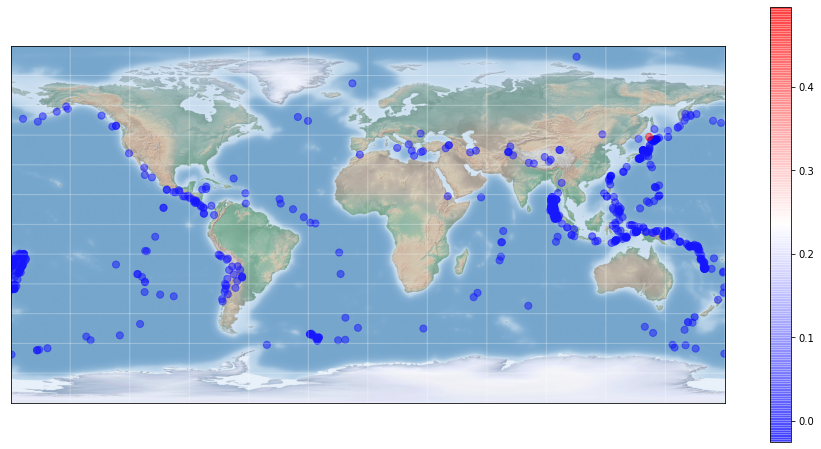

In [78]:
#collapse
fig,ax = plt.subplots(figsize = (16,8))
draw_map(m)
nodes = nx.draw_networkx_nodes(_G1,m_pos1,node_color=_df.query('Year=="2004"').comp6,node_size = 50, ax=ax,cmap='bwr',alpha=0.5)
plt.colorbar(nodes)
plt.axis()
ax.set_axis_on()
ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

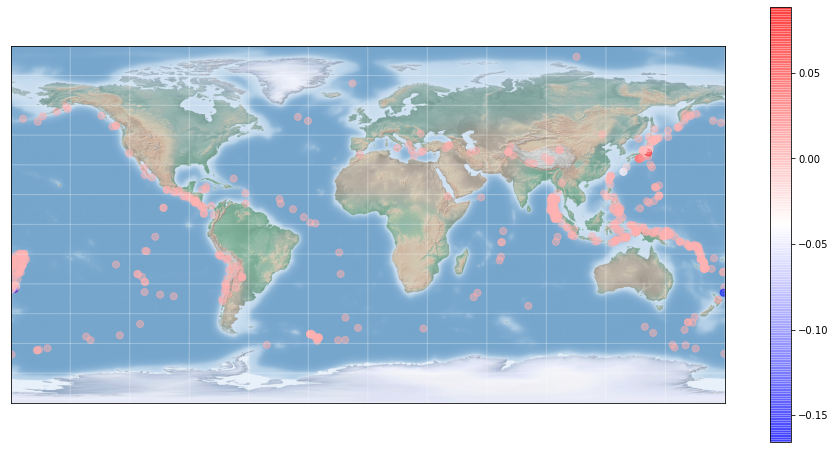

In [80]:
#collapse
fig,ax = plt.subplots(figsize = (16,8))
draw_map(m)
nodes = nx.draw_networkx_nodes(_G1,m_pos1,node_color=_df.query('Year=="2004"').comp7,node_size = 50, ax=ax,cmap='bwr',alpha=0.5)
plt.colorbar(nodes)
plt.axis()
ax.set_axis_on()
ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

##### **2005**, $n=533$

In [81]:
_G2 = nx.Graph(_W[len(_df.query('Year<="2004"')):len(_df.query('Year<="2005"')),len(_df.query('Year<="2004"')):len(_df.query('Year<="2005"'))]-np.identity(len(_df.query('Year=="2005"'))))
_pos2 = nx.spring_layout(_G2,iterations=20)
m_pos2 = list(zip(_df.query('Year=="2005"').Longitude,_df.query('Year=="2005"').Latitude))

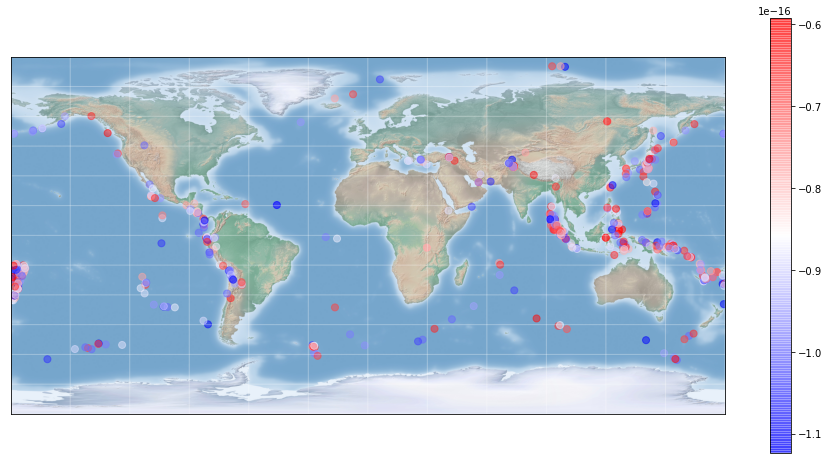

In [85]:
#collapse
fig,ax = plt.subplots(figsize = (16,8))
draw_map(m)
nodes = nx.draw_networkx_nodes(_G2,m_pos2,node_color=_df.query('Year=="2005"').comp1,node_size=50, ax=ax,cmap='bwr',alpha=0.5)
plt.colorbar(nodes)
plt.axis()
ax.set_axis_on()
ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

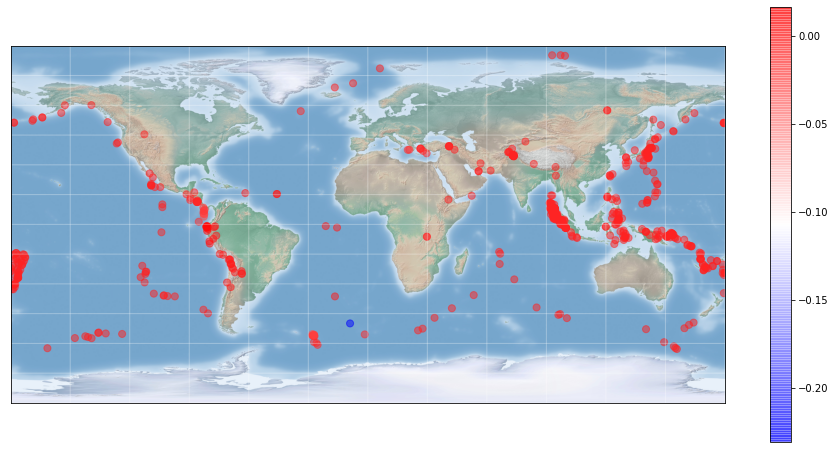

In [95]:
#collapse
fig,ax = plt.subplots(figsize = (16,8))
draw_map(m)
nodes = nx.draw_networkx_nodes(_G2,m_pos2,node_color=_df.query('Year=="2005"').comp2,node_size = 50,ax=ax,cmap='bwr',alpha=0.5)
plt.colorbar(nodes)
plt.axis()
ax.set_axis_on()
ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

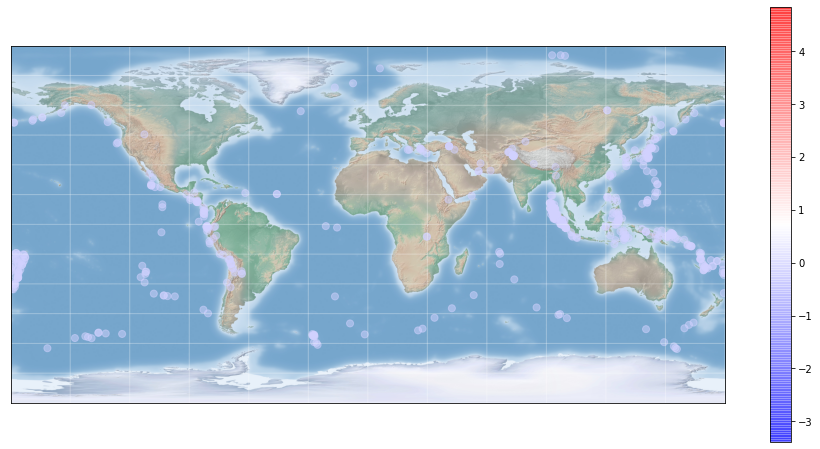

In [98]:
#collapse
fig,ax = plt.subplots(figsize = (16,8))
draw_map(m)
nodes = nx.draw_networkx_nodes(_G2,m_pos2,node_color=_df.query('Year=="2005"').comp3,node_size = 50, ax=ax,cmap='bwr',alpha=0.5)
plt.colorbar(nodes)
plt.axis()
ax.set_axis_on()
ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

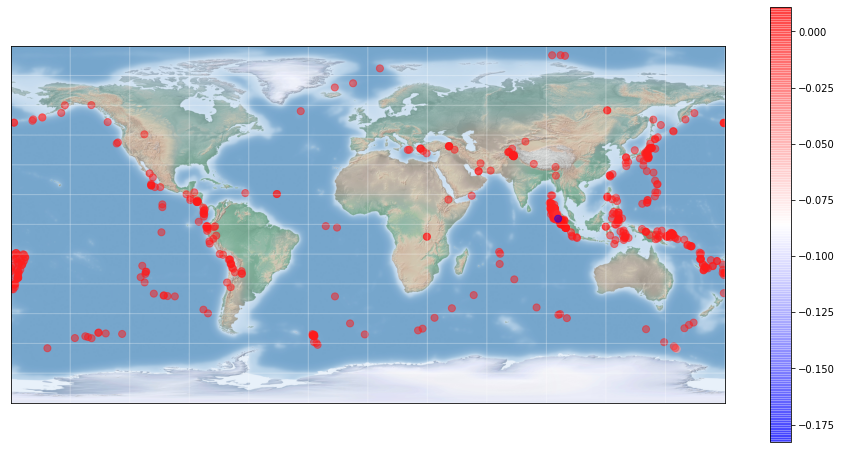

In [100]:
#collapse
fig,ax = plt.subplots(figsize = (16,8))
draw_map(m)
nodes = nx.draw_networkx_nodes(_G2,m_pos2,node_color=_df.query('Year=="2005"').comp4,node_size = 50, ax=ax,cmap='bwr',alpha=0.5)
plt.colorbar(nodes)
plt.axis()
ax.set_axis_on()
ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

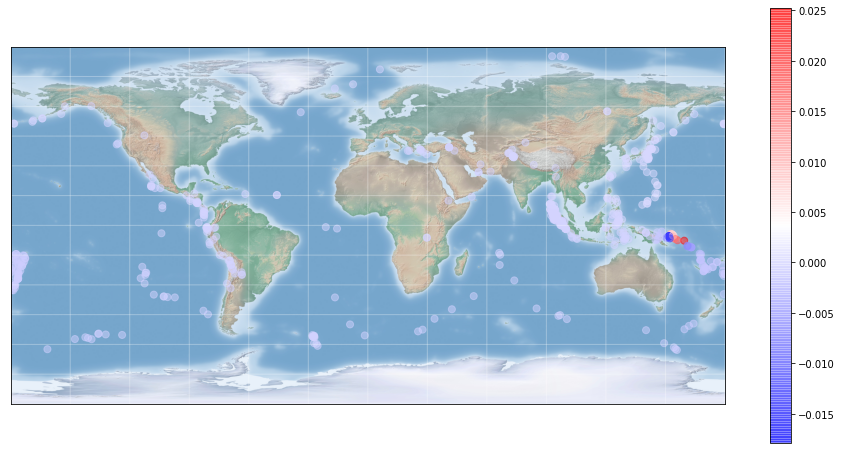

In [102]:
#collapse
fig,ax = plt.subplots(figsize = (16,8))
draw_map(m)
nodes = nx.draw_networkx_nodes(_G2,m_pos2,node_color=_df.query('Year=="2005"').comp5,node_size = 50, ax=ax,cmap='bwr',alpha=0.5)
plt.colorbar(nodes)
plt.axis()
ax.set_axis_on()
ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

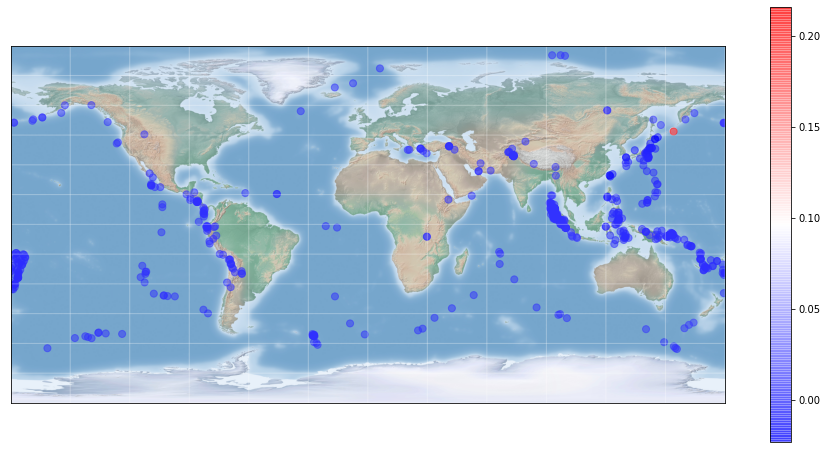

In [104]:
#collapse
fig,ax = plt.subplots(figsize = (16,8))
draw_map(m)
nodes = nx.draw_networkx_nodes(_G2,m_pos2,node_color=_df.query('Year=="2005"').comp6,node_size = 50, ax=ax,cmap='bwr',alpha=0.5)
plt.colorbar(nodes)
plt.axis()
ax.set_axis_on()
ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

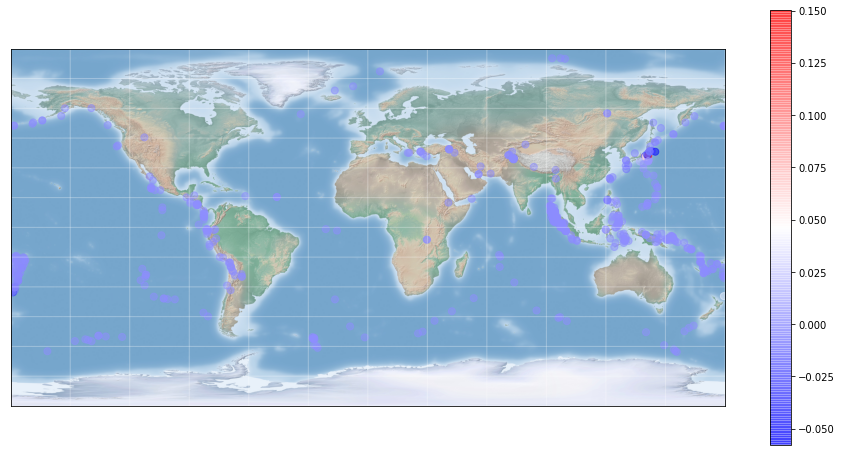

In [111]:
#collapse
fig,ax = plt.subplots(figsize = (16,8))
draw_map(m)
nodes = nx.draw_networkx_nodes(_G2,m_pos2,node_color=_df.query('Year=="2005"').comp7, node_size = 50, ax=ax,cmap='bwr',alpha=0.5)
plt.colorbar(nodes)
plt.axis()
ax.set_axis_on()
ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

##### **2006**, $n=512$

In [112]:
_G3 = nx.Graph(_W[len(_df.query('Year<="2005"')):len(_df.query('Year<="2006"')),len(_df.query('Year<="2005"')):len(_df.query('Year<="2006"'))]-np.identity(len(_df.query('Year=="2006"'))))
_pos3 = nx.spring_layout(_G3,iterations=20)
m_pos3 = list(zip(_df.query('Year=="2006"').Longitude,_df.query('Year=="2006"').Latitude))

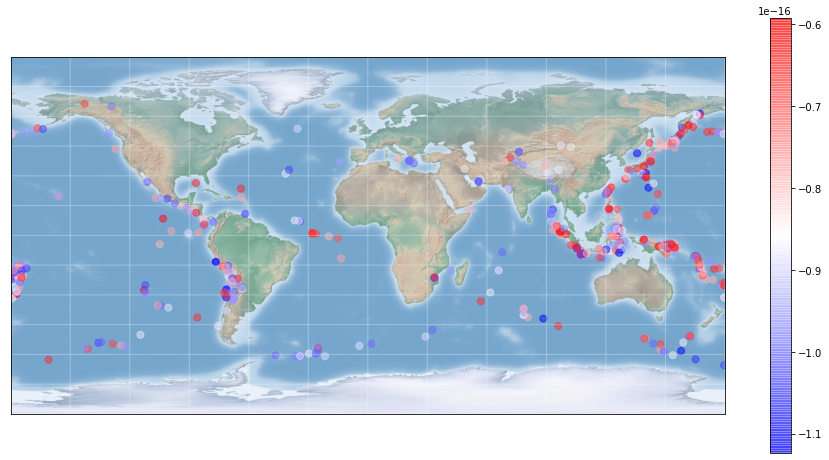

In [114]:
#collapse
fig,ax = plt.subplots(figsize = (16,8))
draw_map(m)
nodes = nx.draw_networkx_nodes(_G3,m_pos3,node_color=_df.query('Year=="2006"').comp1,node_size=50, ax=ax,cmap='bwr',alpha=0.5)
plt.colorbar(nodes)
plt.axis()
ax.set_axis_on()
ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

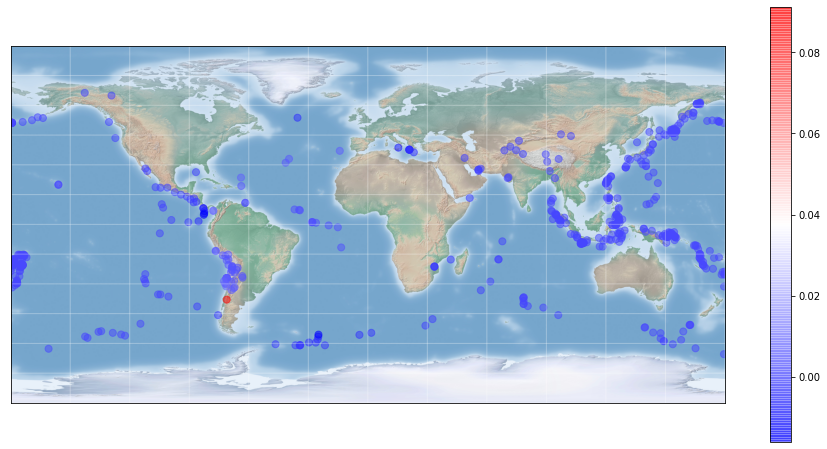

In [116]:
#collapse
fig,ax = plt.subplots(figsize = (16,8))
draw_map(m)
nodes = nx.draw_networkx_nodes(_G3,m_pos3,node_color=_df.query('Year=="2006"').comp2,node_size = 50,ax=ax,cmap='bwr',alpha=0.5)
plt.colorbar(nodes)
plt.axis()
ax.set_axis_on()
ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

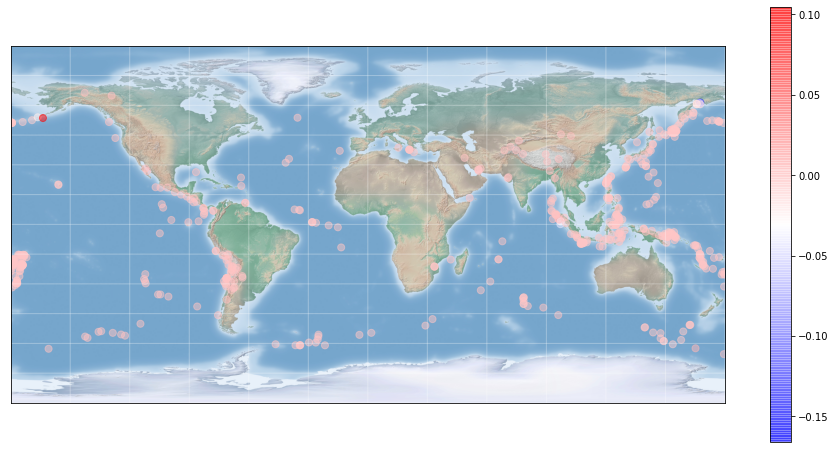

In [118]:
#collapse
fig,ax = plt.subplots(figsize = (16,8))
draw_map(m)
nodes = nx.draw_networkx_nodes(_G3,m_pos3,node_color=_df.query('Year=="2006"').comp3,node_size = 50, ax=ax,cmap='bwr',alpha=0.5)
plt.colorbar(nodes)
plt.axis()
ax.set_axis_on()
ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

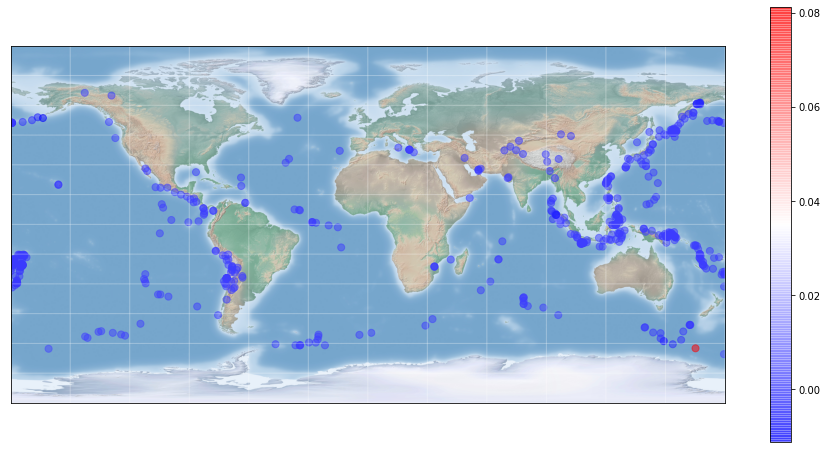

In [120]:
#collapse
fig,ax = plt.subplots(figsize = (16,8))
draw_map(m)
nodes = nx.draw_networkx_nodes(_G3,m_pos3,node_color=_df.query('Year=="2006"').comp4,node_size = 50, ax=ax,cmap='bwr',alpha=0.5)
plt.colorbar(nodes)
plt.axis()
ax.set_axis_on()
ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

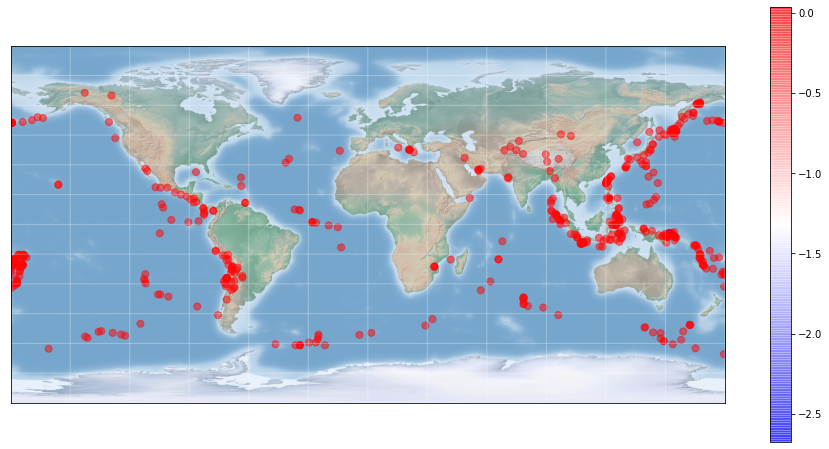

In [121]:
#collapse
fig,ax = plt.subplots(figsize = (16,8))
draw_map(m)
nodes = nx.draw_networkx_nodes(_G3,m_pos3,node_color=_df.query('Year=="2006"').comp5,node_size = 50, ax=ax,cmap='bwr',alpha=0.5)
plt.colorbar(nodes)
plt.axis()
ax.set_axis_on()
ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

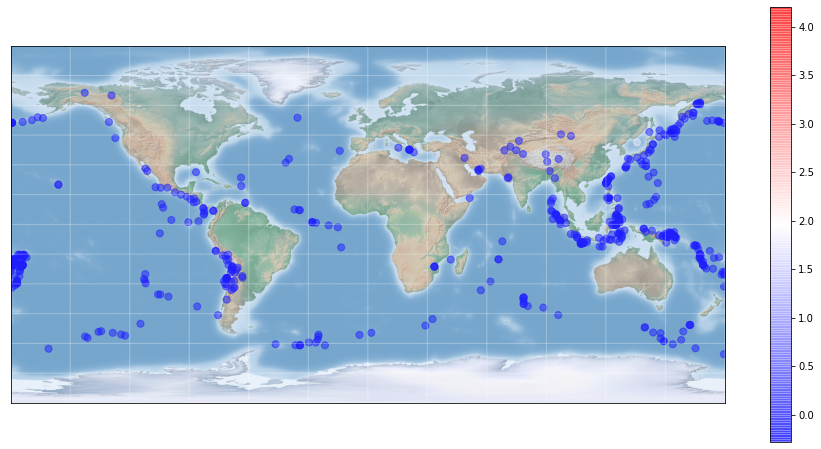

In [122]:
#collapse
fig,ax = plt.subplots(figsize = (16,8))
draw_map(m)
nodes = nx.draw_networkx_nodes(_G3,m_pos3,node_color=_df.query('Year=="2006"').comp6,node_size = 50, ax=ax,cmap='bwr',alpha=0.5)
plt.colorbar(nodes)
plt.axis()
ax.set_axis_on()
ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

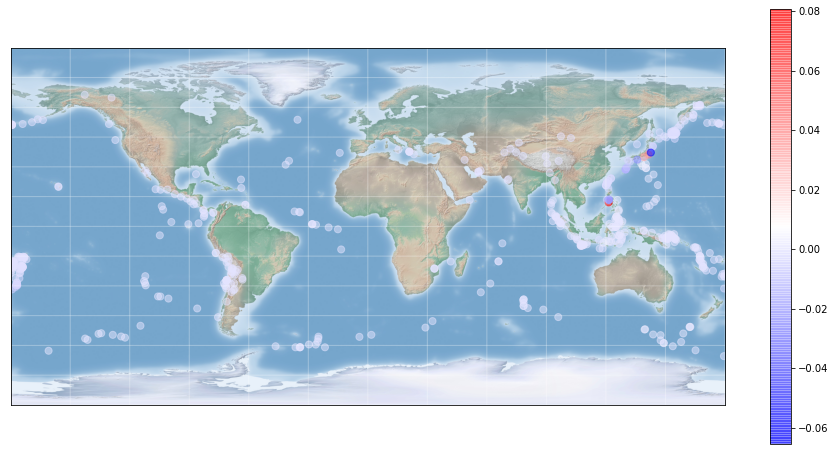

In [123]:
#collapse
fig,ax = plt.subplots(figsize = (16,8))
draw_map(m)
nodes = nx.draw_networkx_nodes(_G3,m_pos3,node_color=_df.query('Year=="2006"').comp7,node_size = 50, ax=ax,cmap='bwr',alpha=0.5)
plt.colorbar(nodes)
plt.axis()
ax.set_axis_on()
ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

##### **2007**, $n=608$

In [124]:
_G4 = nx.Graph(_W[len(_df.query('Year<="2006"')):len(_df.query('Year<="2007"')),len(_df.query('Year<="2006"')):len(_df.query('Year<="2007"'))]-np.identity(len(_df.query('Year=="2007"'))))
_pos4 = nx.spring_layout(_G4,iterations=20)
m_pos4 = list(zip(_df.query('Year=="2007"').Longitude,_df.query('Year=="2007"').Latitude))

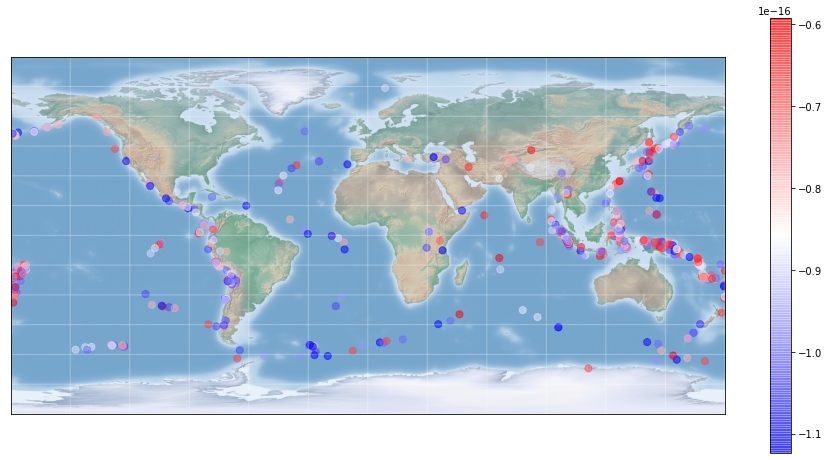

In [126]:
#collapse
fig,ax = plt.subplots(figsize = (16,8))
draw_map(m)
nodes = nx.draw_networkx_nodes(_G4,m_pos4,node_color=_df.query('Year=="2007"').comp1,node_size = 50, ax=ax,cmap='bwr',alpha=0.5)
plt.colorbar(nodes)
plt.axis()
ax.set_axis_on()
ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

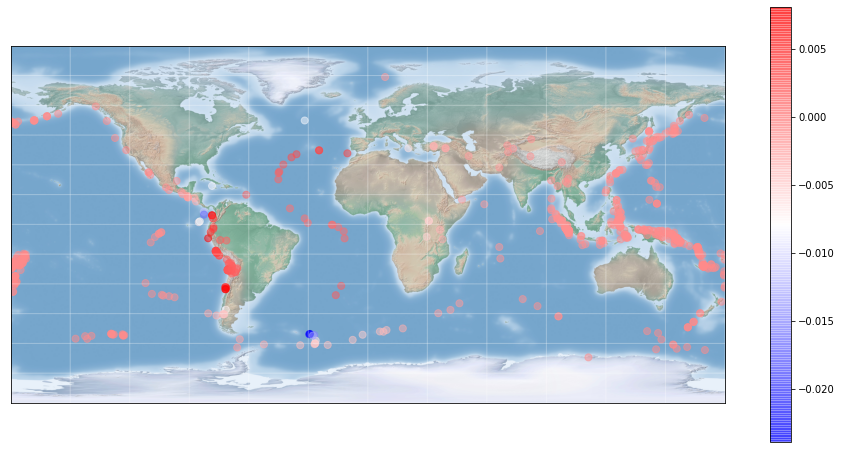

In [128]:
#collapse
fig,ax = plt.subplots(figsize = (16,8))
draw_map(m)
nodes = nx.draw_networkx_nodes(_G4,m_pos4,node_color=_df.query('Year=="2007"').comp2,node_size = 50,ax=ax,cmap='bwr',alpha=0.5)
plt.colorbar(nodes)
plt.axis()
ax.set_axis_on()
ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

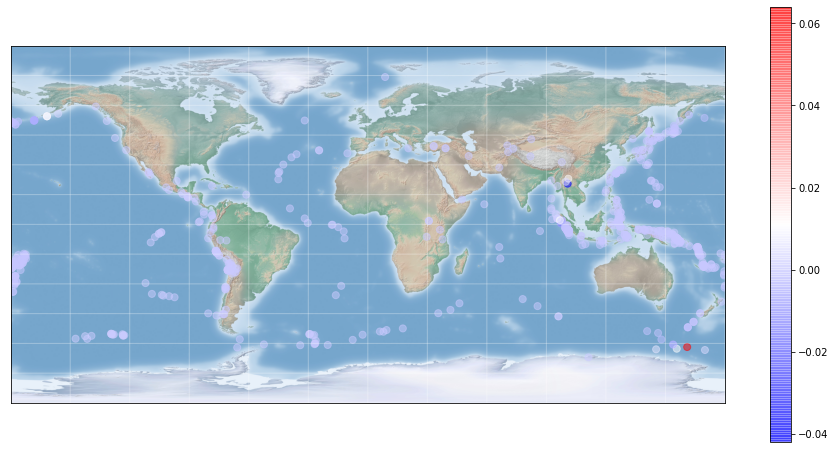

In [129]:
#collapse
fig,ax = plt.subplots(figsize = (16,8))
draw_map(m)
nodes = nx.draw_networkx_nodes(_G4,m_pos4,node_color=_df.query('Year=="2007"').comp3,node_size =50, ax=ax,cmap='bwr',alpha=0.5)
plt.colorbar(nodes)
plt.axis()
ax.set_axis_on()
ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

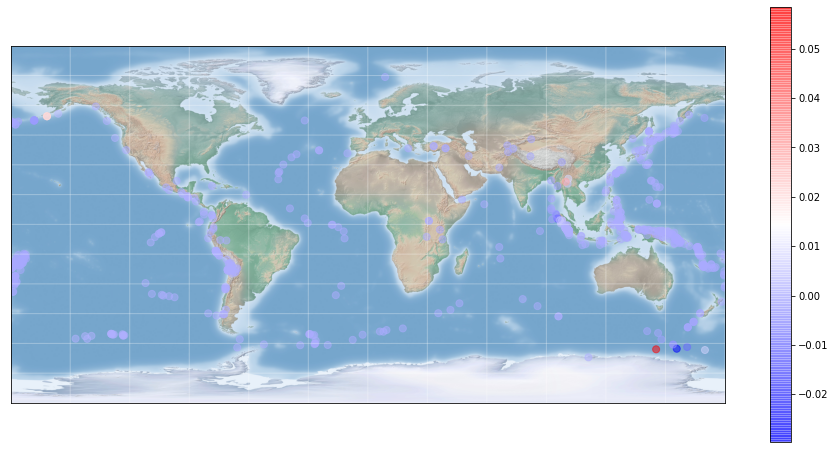

In [130]:
#collapse
fig,ax = plt.subplots(figsize = (16,8))
draw_map(m)
nodes = nx.draw_networkx_nodes(_G4,m_pos4,node_color=_df.query('Year=="2007"').comp4,node_size = 50, ax=ax,cmap='bwr',alpha=0.5)
plt.colorbar(nodes)
plt.axis()
ax.set_axis_on()
ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

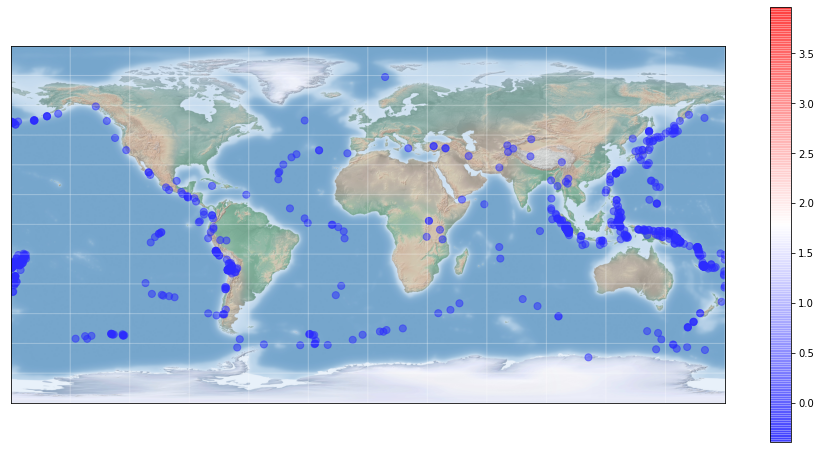

In [131]:
#collapse
fig,ax = plt.subplots(figsize = (16,8))
draw_map(m)
nodes = nx.draw_networkx_nodes(_G4,m_pos4,node_color=_df.query('Year=="2007"').comp5,node_size = 50, ax=ax,cmap='bwr',alpha=0.5)
plt.colorbar(nodes)
plt.axis()
ax.set_axis_on()
ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

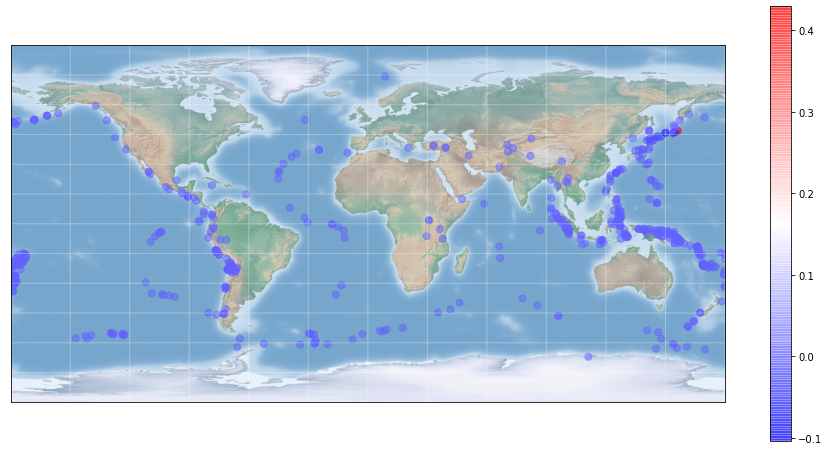

In [132]:
#collapse
fig,ax = plt.subplots(figsize = (16,8))
draw_map(m)
nodes = nx.draw_networkx_nodes(_G4,m_pos4,node_color=_df.query('Year=="2007"').comp6,node_size = 50, ax=ax,cmap='bwr',alpha=0.5)
plt.colorbar(nodes)
plt.axis()
ax.set_axis_on()
ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

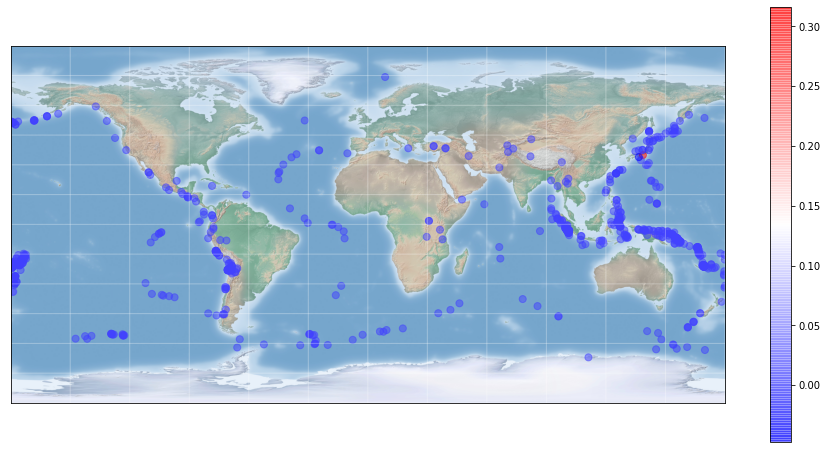

In [133]:
#collapse
fig,ax = plt.subplots(figsize = (16,8))
draw_map(m)
nodes = nx.draw_networkx_nodes(_G4,m_pos4,node_color=_df.query('Year=="2007"').comp7,node_size = 50, ax=ax,cmap='bwr',alpha=0.5)
plt.colorbar(nodes)
plt.axis()
ax.set_axis_on()
ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

##### **2008**, $n=508$

In [134]:
_G5 = nx.Graph(_W[len(_df.query('Year<="2007"')):len(_df.query('Year<="2008"')),len(_df.query('Year<="2007"')):len(_df.query('Year<="2008"'))]-np.identity(len(_df.query('Year=="2008"'))))
_pos5 = nx.spring_layout(_G5,iterations=20)
m_pos5 = list(zip(_df.query('Year=="2008"').Longitude,_df.query('Year=="2008"').Latitude))

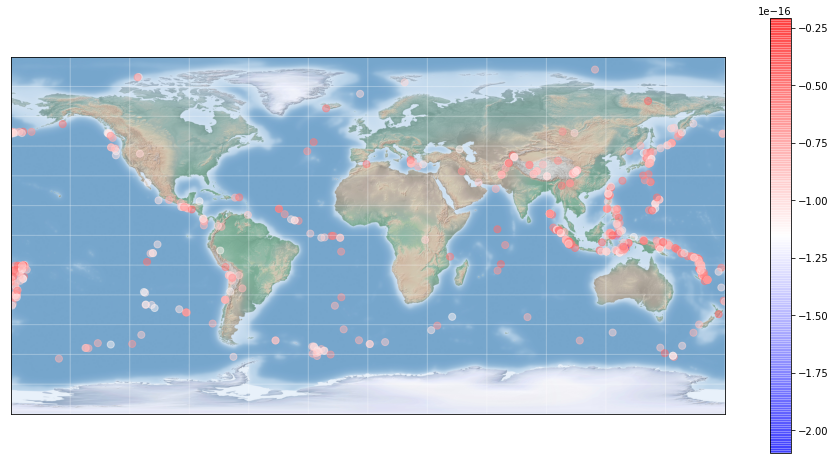

In [135]:
#collapse
fig,ax = plt.subplots(figsize = (16,8))
draw_map(m)
nodes = nx.draw_networkx_nodes(_G5,m_pos5,node_color=_df.query('Year=="2008"').comp1,node_size = 50, ax=ax,cmap='bwr',alpha=0.5)
plt.colorbar(nodes)
plt.axis()
ax.set_axis_on()
ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

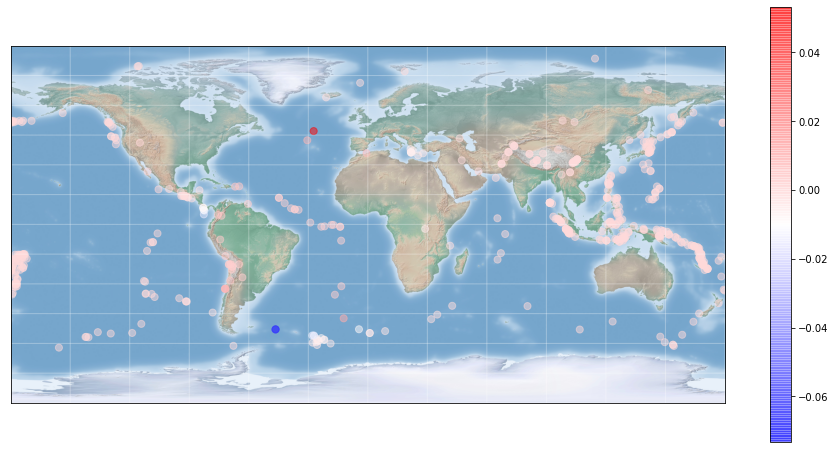

In [136]:
#collapse
fig,ax = plt.subplots(figsize = (16,8))
draw_map(m)
nodes = nx.draw_networkx_nodes(_G5,m_pos5,node_color=_df.query('Year=="2008"').comp2,node_size = 50,ax=ax,cmap='bwr',alpha=0.5)
plt.colorbar(nodes)
plt.axis()
ax.set_axis_on()
ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

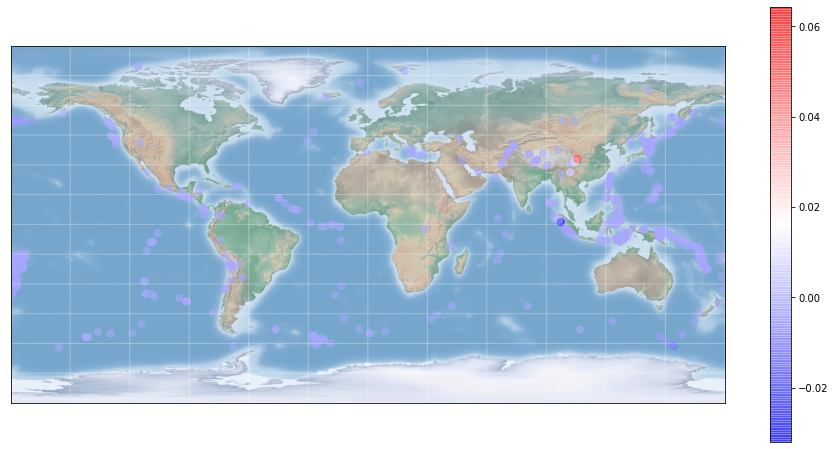

In [137]:
#collapse
fig,ax = plt.subplots(figsize = (16,8))
draw_map(m)
nodes = nx.draw_networkx_nodes(_G5,m_pos5,node_color=_df.query('Year=="2008"').comp3,node_size = 50, ax=ax,cmap='bwr',alpha=0.5)
plt.colorbar(nodes)
plt.axis()
ax.set_axis_on()
ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

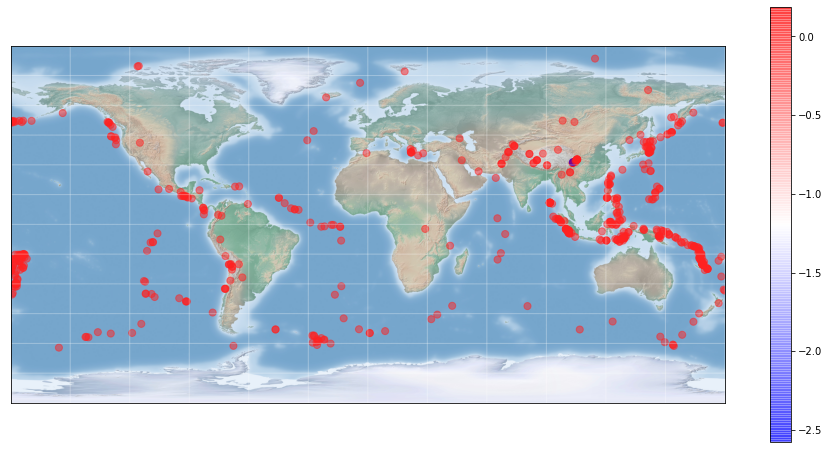

In [138]:
#collapse
fig,ax = plt.subplots(figsize = (16,8))
draw_map(m)
nodes = nx.draw_networkx_nodes(_G5,m_pos5,node_color=_df.query('Year=="2008"').comp4,node_size = 50, ax=ax,cmap='bwr',alpha=0.5)
plt.colorbar(nodes)
plt.axis()
ax.set_axis_on()
ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

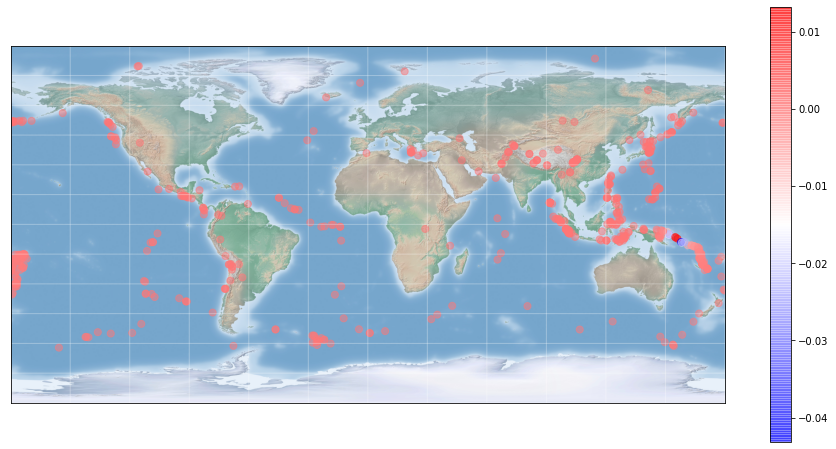

In [140]:
#collapse
fig,ax = plt.subplots(figsize = (16,8))
draw_map(m)
nodes = nx.draw_networkx_nodes(_G5,m_pos5,node_color=_df.query('Year=="2008"').comp5,node_size = 50, ax=ax,cmap='bwr',alpha=0.5)
plt.colorbar(nodes)
plt.axis()
ax.set_axis_on()
ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

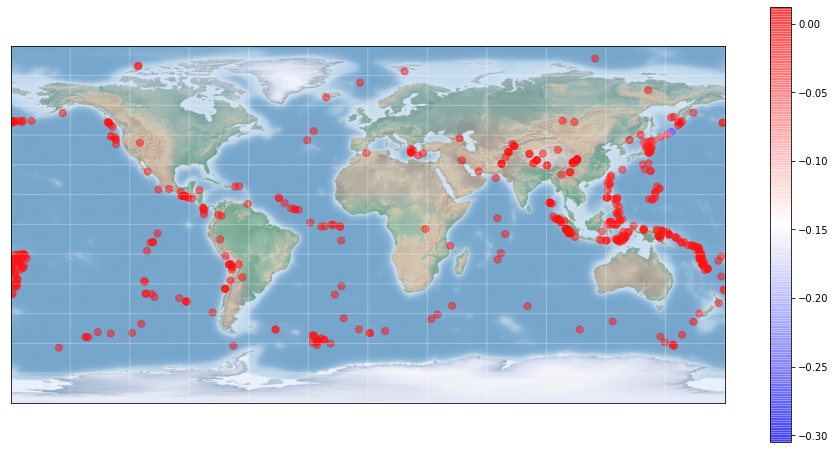

In [141]:
#collapse
fig,ax = plt.subplots(figsize = (16,8))
draw_map(m)
nodes = nx.draw_networkx_nodes(_G5,m_pos5,node_color=_df.query('Year=="2008"').comp6,node_size = 50, ax=ax,cmap='bwr',alpha=0.5)
plt.colorbar(nodes)
plt.axis()
ax.set_axis_on()
ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

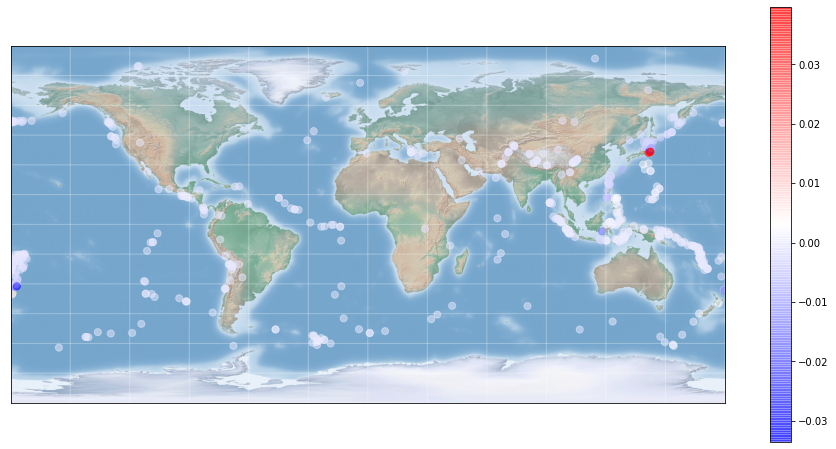

In [142]:
#collapse
fig,ax = plt.subplots(figsize = (16,8))
draw_map(m)
nodes = nx.draw_networkx_nodes(_G5,m_pos5,node_color=_df.query('Year=="2008"').comp7,node_size = 50, ax=ax,cmap='bwr',alpha=0.5)
plt.colorbar(nodes)
plt.axis()
ax.set_axis_on()
ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

##### **2009**, $n=517$

In [143]:
_G6 = nx.Graph(_W[len(_df.query('Year<="2008"')):len(_df.query('Year<="2009"')),len(_df.query('Year<="2008"')):len(_df.query('Year<="2009"'))]-np.identity(len(_df.query('Year=="2009"'))))
_pos6 = nx.spring_layout(_G6,iterations=20)
m_pos6 = list(zip(_df.query('Year=="2009"').Longitude,_df.query('Year=="2009"').Latitude))

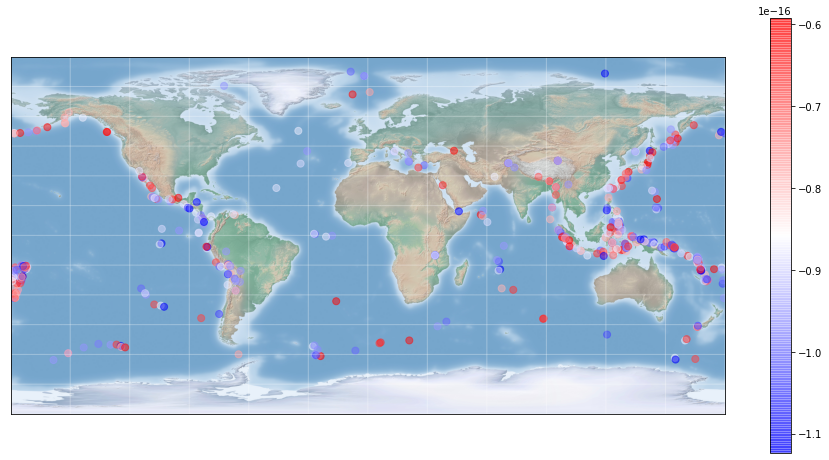

In [144]:
#collapse
fig,ax = plt.subplots(figsize = (16,8))
draw_map(m)
nodes = nx.draw_networkx_nodes(_G6,m_pos6,node_color=_df.query('Year=="2009"').comp1,node_size = 50, ax=ax,cmap='bwr',alpha=0.5)
plt.colorbar(nodes)
plt.axis()
ax.set_axis_on()
ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

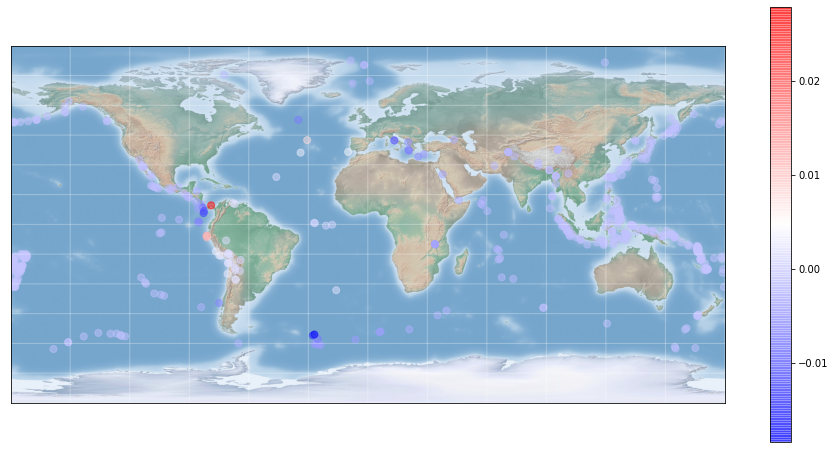

In [145]:
#collapse
fig,ax = plt.subplots(figsize = (16,8))
draw_map(m)
nodes = nx.draw_networkx_nodes(_G6,m_pos6,node_color=_df.query('Year=="2009"').comp2,node_size = 50,ax=ax,cmap='bwr',alpha=0.5)
plt.colorbar(nodes)
plt.axis()
ax.set_axis_on()
ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

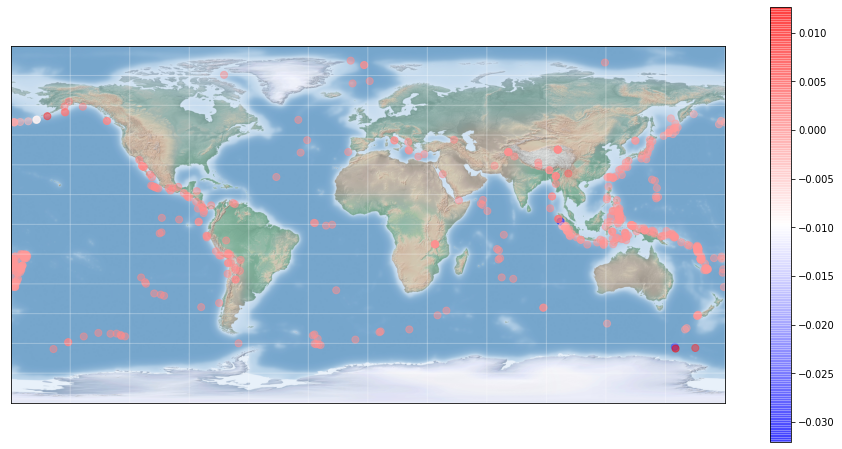

In [146]:
#collapse
fig,ax = plt.subplots(figsize = (16,8))
draw_map(m)
nodes = nx.draw_networkx_nodes(_G6,m_pos6,node_color=_df.query('Year=="2009"').comp3,node_size = 50, ax=ax,cmap='bwr',alpha=0.5)
plt.colorbar(nodes)
plt.axis()
ax.set_axis_on()
ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

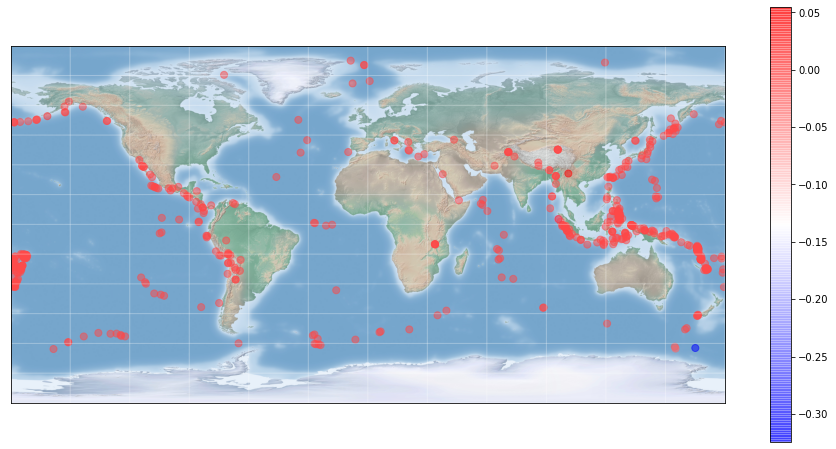

In [147]:
#collapse
fig,ax = plt.subplots(figsize = (16,8))
draw_map(m)
nodes = nx.draw_networkx_nodes(_G6,m_pos6,node_color=_df.query('Year=="2009"').comp4,node_size = 50, ax=ax,cmap='bwr',alpha=0.5)
plt.colorbar(nodes)
plt.axis()
ax.set_axis_on()
ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

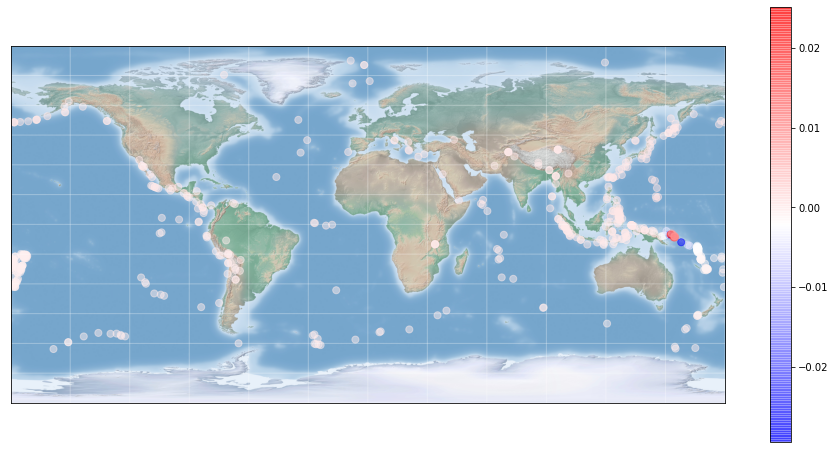

In [148]:
#collapse
fig,ax = plt.subplots(figsize = (16,8))
draw_map(m)
nodes = nx.draw_networkx_nodes(_G6,m_pos6,node_color=_df.query('Year=="2009"').comp5,node_size = 50, ax=ax,cmap='bwr',alpha=0.5)
plt.colorbar(nodes)
plt.axis()
ax.set_axis_on()
ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

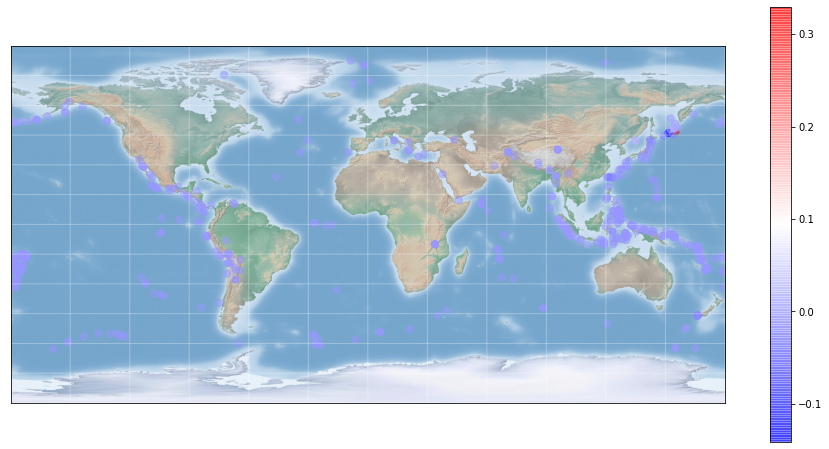

In [150]:
#collapse
fig,ax = plt.subplots(figsize = (16,8))
draw_map(m)
nodes = nx.draw_networkx_nodes(_G6,m_pos6,node_color=_df.query('Year=="2009"').comp6,node_size = 50, ax=ax,cmap='bwr',alpha=0.5)
plt.colorbar(nodes)
plt.axis()
ax.set_axis_on()
ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

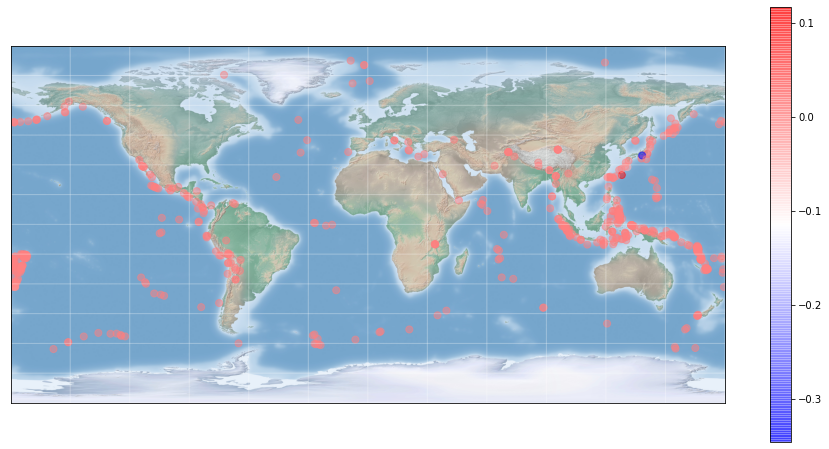

In [151]:
#collapse
fig,ax = plt.subplots(figsize = (16,8))
draw_map(m)
nodes = nx.draw_networkx_nodes(_G6,m_pos6,node_color=_df.query('Year=="2009"').comp7,node_size = 50, ax=ax,cmap='bwr',alpha=0.5)
plt.colorbar(nodes)
plt.axis()
ax.set_axis_on()
ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

##### **2010**, $n=560$

In [152]:
_G7 = nx.Graph(_W[len(_df.query('Year<="2009"')):len(_df.query('Year<="2010"')),len(_df.query('Year<="2009"')):len(_df.query('Year<="2010"'))]-np.identity(len(_df.query('Year=="2010"'))))
_pos7 = nx.spring_layout(_G7,iterations=20)
m_pos7 = list(zip(_df.query('Year=="2010"').Longitude,_df.query('Year=="2010"').Latitude))

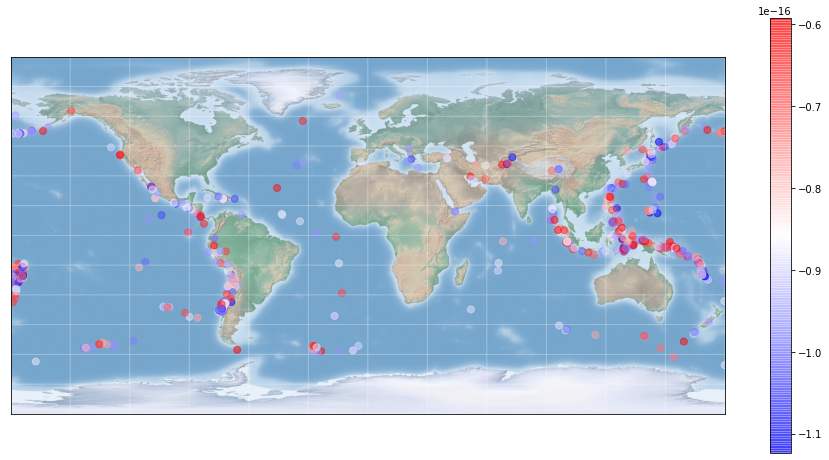

In [153]:
#collapse
fig,ax = plt.subplots(figsize = (16,8))
draw_map(m)
nodes = nx.draw_networkx_nodes(_G7,m_pos7,node_color=_df.query('Year=="2010"').comp1,node_size = 50, ax=ax,cmap='bwr',alpha=0.5)
plt.colorbar(nodes)
plt.axis()
ax.set_axis_on()
ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

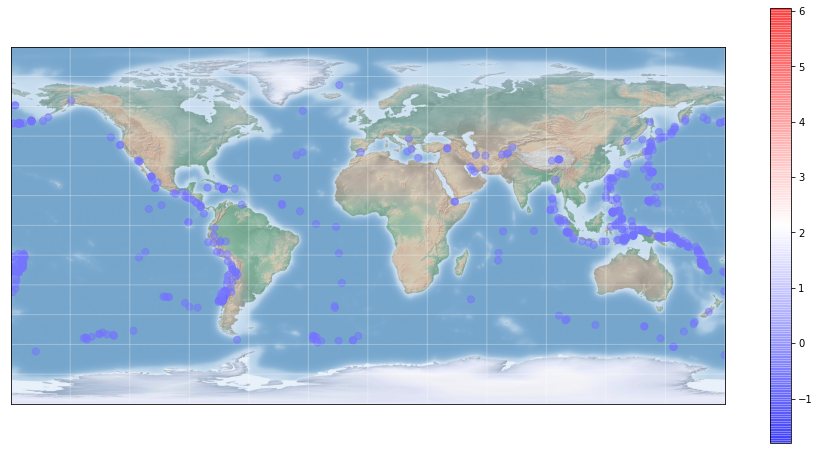

In [154]:
#collapse
fig,ax = plt.subplots(figsize = (16,8))
draw_map(m)
nodes = nx.draw_networkx_nodes(_G7,m_pos7,node_color=_df.query('Year=="2010"').comp2,node_size = 50,ax=ax,cmap='bwr',alpha=0.5)
plt.colorbar(nodes)
plt.axis()
ax.set_axis_on()
ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

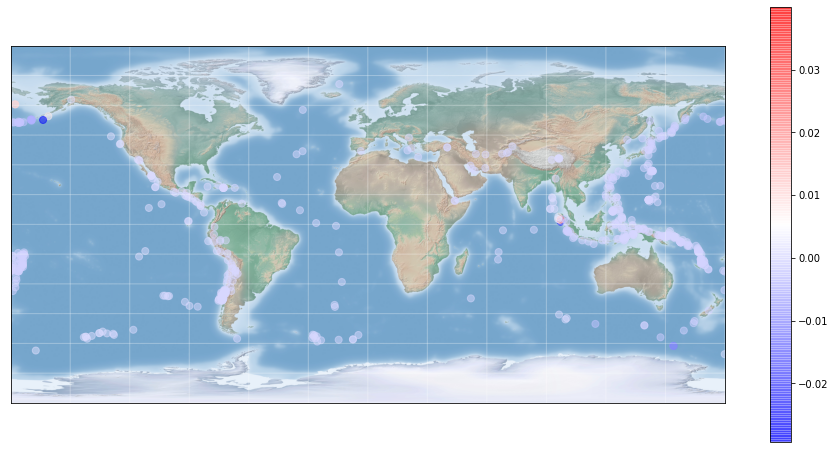

In [156]:
#collapse
fig,ax = plt.subplots(figsize = (16,8))
draw_map(m)
nodes = nx.draw_networkx_nodes(_G7,m_pos7,node_color=_df.query('Year=="2010"').comp3,node_size = 50, ax=ax,cmap='bwr',alpha=0.5)
plt.colorbar(nodes)
plt.axis()
ax.set_axis_on()
ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

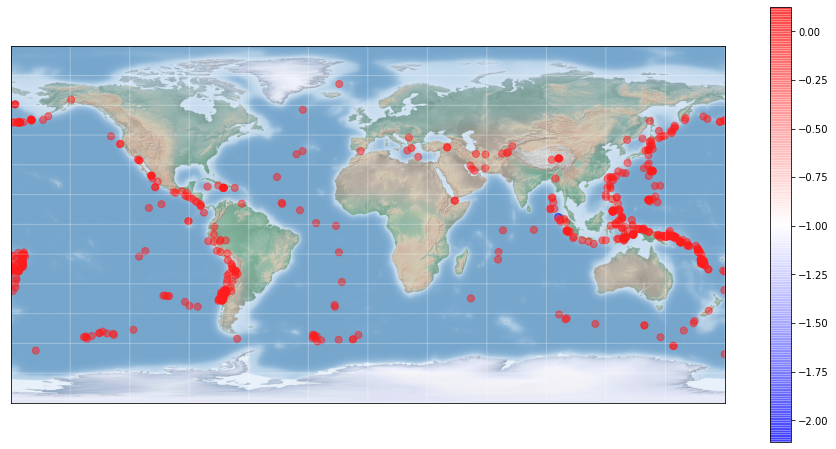

In [157]:
#collapse
fig,ax = plt.subplots(figsize = (16,8))
draw_map(m)
nodes = nx.draw_networkx_nodes(_G7,m_pos7,node_color=_df.query('Year=="2010"').comp4,node_size = 50, ax=ax,cmap='bwr',alpha=0.5)
plt.colorbar(nodes)
plt.axis()
ax.set_axis_on()
ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

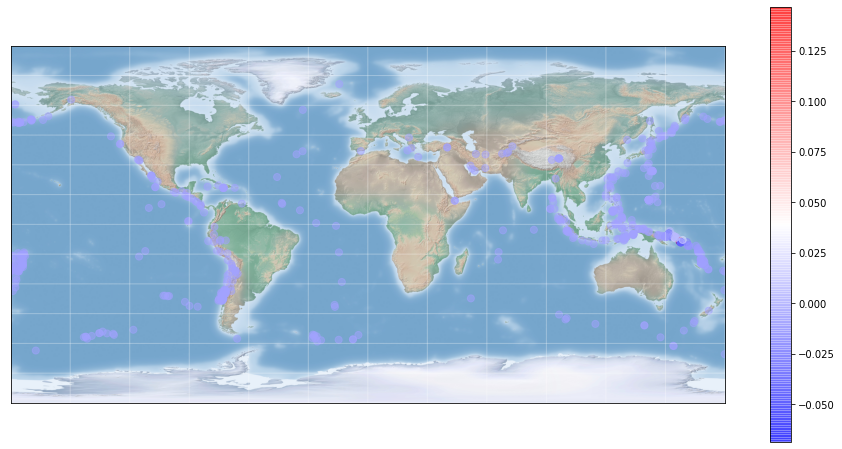

In [158]:
#collapse
fig,ax = plt.subplots(figsize = (16,8))
draw_map(m)
nodes = nx.draw_networkx_nodes(_G7,m_pos7,node_color=_df.query('Year=="2010"').comp5,node_size = 50, ax=ax,cmap='bwr',alpha=0.5)
plt.colorbar(nodes)
plt.axis()
ax.set_axis_on()
ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

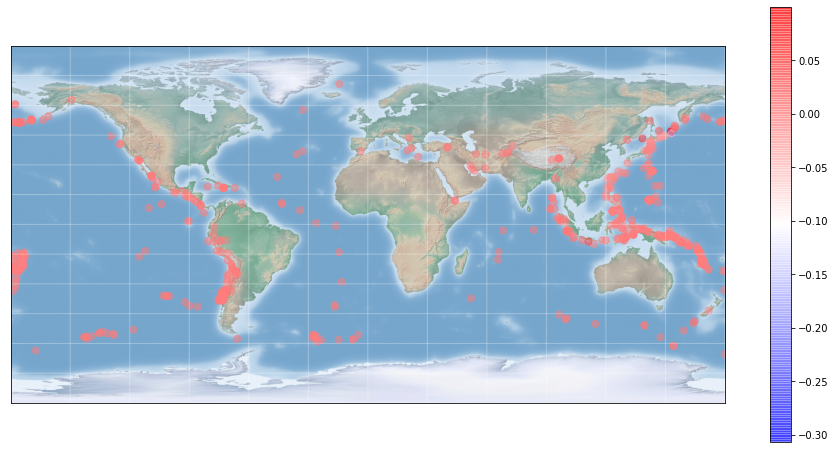

In [160]:
#collapse
fig,ax = plt.subplots(figsize = (16,8))
draw_map(m)
nodes = nx.draw_networkx_nodes(_G7,m_pos7,node_color=_df.query('Year=="2010"').comp6,node_size = 50, ax=ax,cmap='bwr',alpha=0.5)
plt.colorbar(nodes)
plt.axis()
ax.set_axis_on()
ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

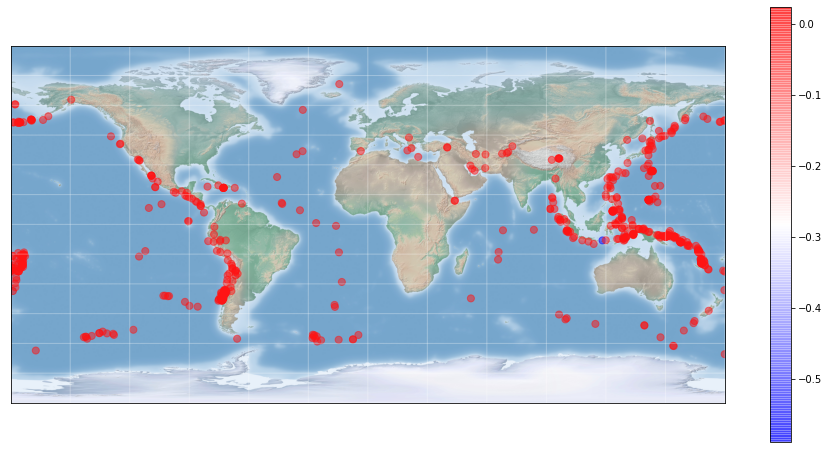

In [161]:
#collapse
fig,ax = plt.subplots(figsize = (16,8))
draw_map(m)
nodes = nx.draw_networkx_nodes(_G7,m_pos7,node_color=_df.query('Year=="2010"').comp7,node_size = 50, ax=ax,cmap='bwr',alpha=0.5)
plt.colorbar(nodes)
plt.axis()
ax.set_axis_on()
ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

##### **2011**, $n=712$

In [162]:
_G8 = nx.Graph(_W[len(_df.query('Year<="2010"')):len(_df.query('Year<="2011"')),len(_df.query('Year<="2010"')):len(_df.query('Year<="2011"'))]-np.identity(len(_df.query('Year=="2011"'))))
_pos8 = nx.spring_layout(_G8,iterations=20)
m_pos8 = list(zip(_df.query('Year=="2011"').Longitude,_df.query('Year=="2011"').Latitude))

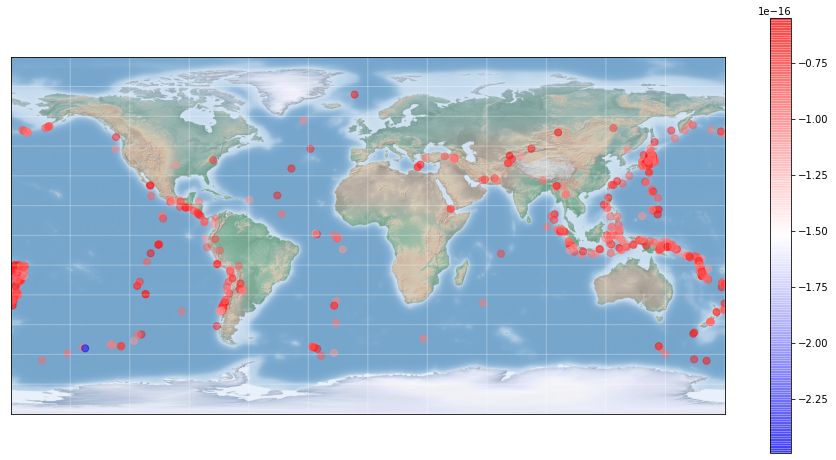

In [163]:
#collapse
fig,ax = plt.subplots(figsize = (16,8))
draw_map(m)
nodes = nx.draw_networkx_nodes(_G8,m_pos8,node_color=_df.query('Year=="2011"').comp1,node_size = 50, ax=ax,cmap='bwr',alpha=0.5)
plt.colorbar(nodes)
plt.axis()
ax.set_axis_on()
ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

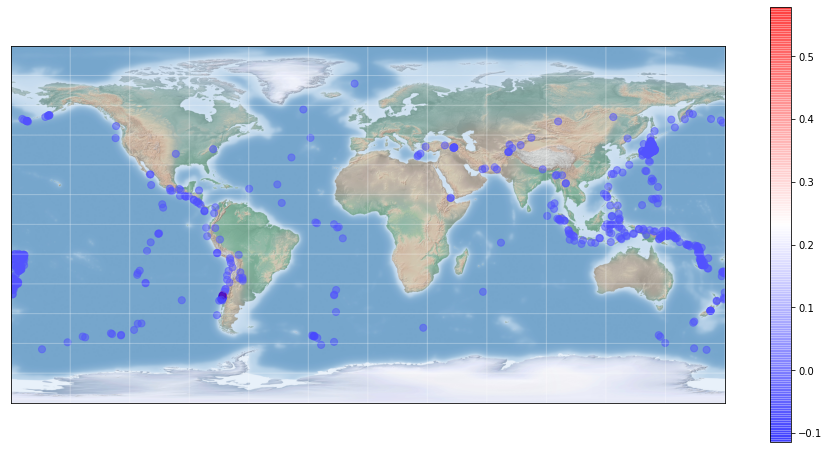

In [164]:
#collapse
fig,ax = plt.subplots(figsize = (16,8))
draw_map(m)
nodes = nx.draw_networkx_nodes(_G8,m_pos8,node_color=_df.query('Year=="2011"').comp2,node_size = 50,ax=ax,cmap='bwr',alpha=0.5)
plt.colorbar(nodes)
plt.axis()
ax.set_axis_on()
ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

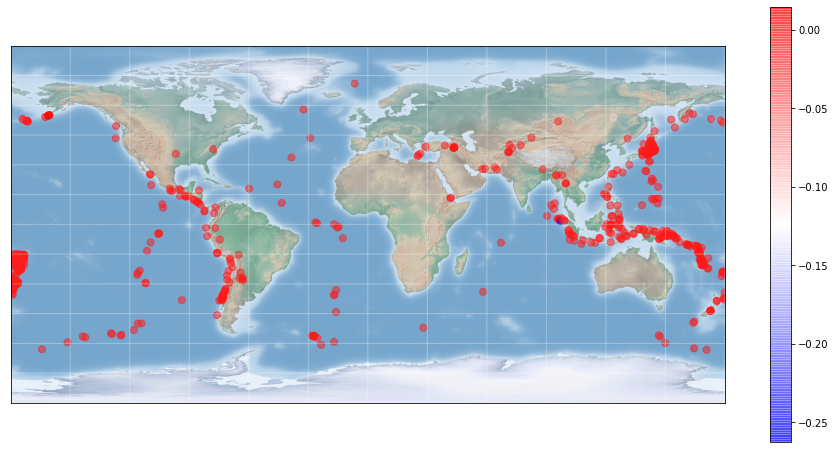

In [165]:
#collapse
fig,ax = plt.subplots(figsize = (16,8))
draw_map(m)
nodes = nx.draw_networkx_nodes(_G8,m_pos8,node_color=_df.query('Year=="2011"').comp3,node_size = 50, ax=ax,cmap='bwr',alpha=0.5)
plt.colorbar(nodes)
plt.axis()
ax.set_axis_on()
ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

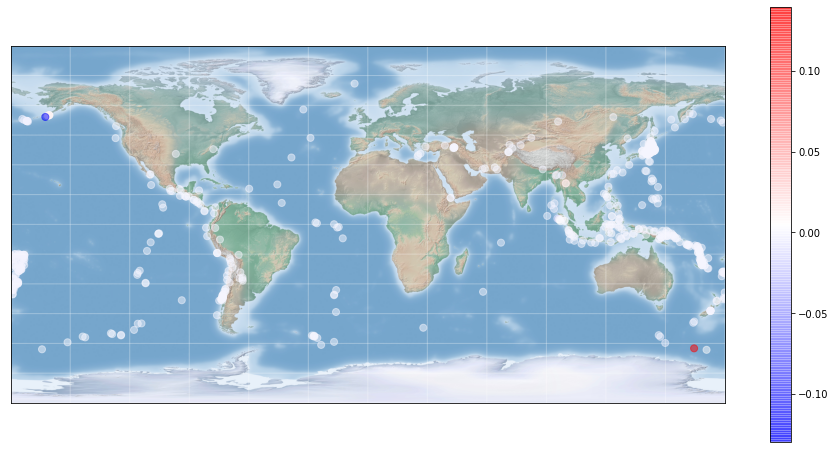

In [166]:
#collapse
fig,ax = plt.subplots(figsize = (16,8))
draw_map(m)
nodes = nx.draw_networkx_nodes(_G8,m_pos8,node_color=_df.query('Year=="2011"').comp4,node_size = 50, ax=ax,cmap='bwr',alpha=0.5)
plt.colorbar(nodes)
plt.axis()
ax.set_axis_on()
ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

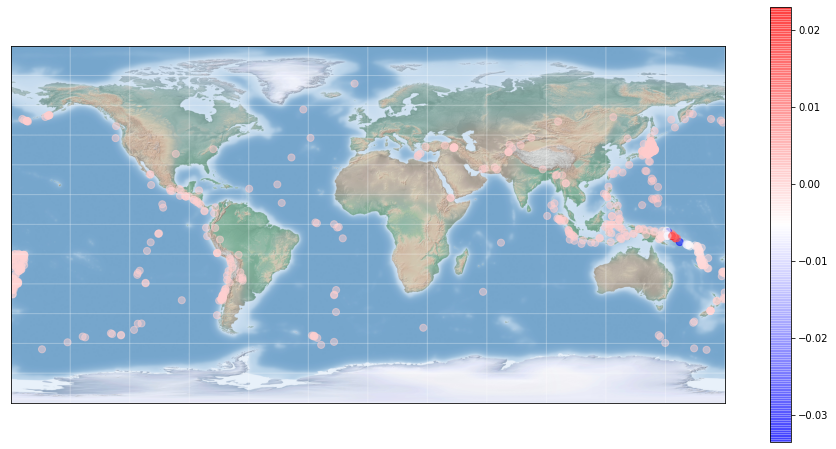

In [167]:
#collapse
fig,ax = plt.subplots(figsize = (16,8))
draw_map(m)
nodes = nx.draw_networkx_nodes(_G8,m_pos8,node_color=_df.query('Year=="2011"').comp5,node_size = 50, ax=ax,cmap='bwr',alpha=0.5)
plt.colorbar(nodes)
plt.axis()
ax.set_axis_on()
ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

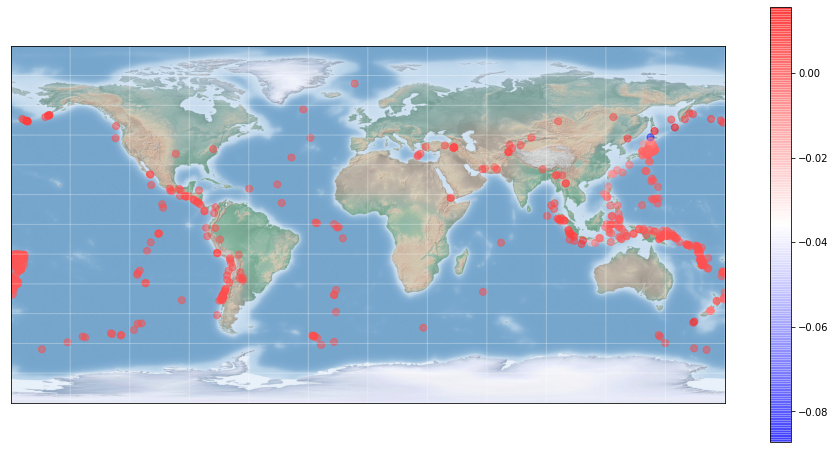

In [168]:
#collapse
fig,ax = plt.subplots(figsize = (16,8))
draw_map(m)
nodes = nx.draw_networkx_nodes(_G8,m_pos8,node_color=_df.query('Year=="2011"').comp6,node_size = 50, ax=ax,cmap='bwr',alpha=0.5)
plt.colorbar(nodes)
plt.axis()
ax.set_axis_on()
ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)

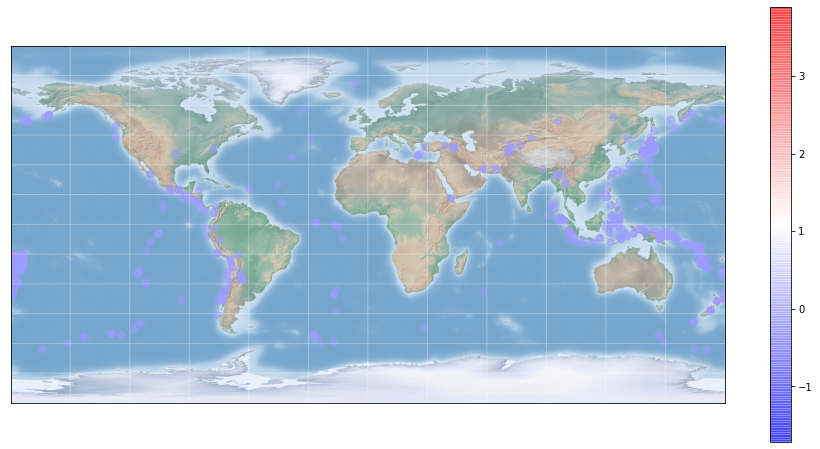

In [169]:
#collapse
fig,ax = plt.subplots(figsize = (16,8))
draw_map(m)
nodes = nx.draw_networkx_nodes(_G8,m_pos8,node_color=_df.query('Year=="2011"').comp7,node_size = 50, ax=ax,cmap='bwr',alpha=0.5)
plt.colorbar(nodes)
plt.axis()
ax.set_axis_on()
ax.tick_params(left=True, bottom=True, labelleft=True, labelbottom=True)